# Capstone 

## Problem Statement

As an executive in a record company, my task is to improve the recently launched streaming service and ameliorate customers experience by building a tool that will recommend similar songs based on previous songs played or researched songs. By improving customers experience, The company will be able to retainn more customers after the trial period.

## Data Cleaning 

Import cell 

In [223]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from re import search
from sklearn.preprocessing import StandardScaler
from scipy import sparse
from sklearn.metrics.pairwise import pairwise_distances, cosine_distances, cosine_similarity

First, I need to read the data and preview it's content

In [2]:
df = pd.read_csv('data/audiio.csv')

In [3]:
df.head()

,songid,performer,song,spotify_genre,spotify_track_id,spotify_track_preview_url,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,"AdictoTainy, Anuel AA & Ozuna","Tainy, Anuel AA & Ozuna",Adicto,['pop reggaeton'],3jbT1Y5MoPwEIpZndDDwVq,NaN,Adicto (with Anuel AA & Ozuna),False,270740.0,91.0,...,10.0,-4.803,False,0.0735,0.01700,0.000016,0.1790,0.623,80.002,4.0
1,The Ones That Didn't Make It Back HomeJustin M...,Justin Moore,The Ones That Didn't Make It Back Home,"['arkansas country', 'contemporary country', '...",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,ShallowLady Gaga & Bradley Cooper,Lady Gaga & Bradley Cooper,Shallow,"['dance pop', 'pop']",2VxeLyX666F8uXCJ0dZF8B,NaN,A Star Is Born Soundtrack,False,215733.0,88.0,...,7.0,-6.362,True,0.0308,0.37100,0.000000,0.2310,0.323,95.799,4.0
3,EnemiesPost Malone Featuring DaBaby,Post Malone Featuring DaBaby,Enemies,"['dfw rap', 'melodic rap', 'rap']",0Xek5rqai2jcOWCYWJfVCF,NaN,Hollywood's Bleeding,True,196760.0,86.0,...,6.0,-4.169,True,0.2100,0.05880,0.000000,0.0955,0.667,76.388,4.0
4,"Bacc At It AgainYella Beezy, Gucci Mane & Quavo","Yella Beezy, Gucci Mane & Quavo",Bacc At It Again,"['dfw rap', 'rap', 'southern hip hop', 'trap']",2biNa12dMbHJrHVFRt8JyO,https://p.scdn.co/mp3-preview/fa6fa6f6f363be29...,Bacc At It Again,True,228185.0,61.0,...,8.0,-5.725,False,0.1680,0.00124,0.000001,0.0716,0.856,135.979,4.0


Let's see how many values I have in my dataframe, their data types and if there are any nulls:

In [4]:
df.shape

(28492, 22)

In [5]:
df.dtypes

songid                        object
performer                     object
song                          object
spotify_genre                 object
spotify_track_id              object
spotify_track_preview_url     object
spotify_track_album           object
spotify_track_explicit        object
spotify_track_duration_ms    float64
spotify_track_popularity     float64
danceability                 float64
energy                       float64
key                          float64
loudness                     float64
mode                          object
speechiness                  float64
acousticness                 float64
instrumentalness             float64
liveness                     float64
valence                      float64
tempo                        float64
time_signature               float64
dtype: object

In [6]:
df.isnull().sum()

songid                           0
performer                        0
song                             0
spotify_genre                 1232
spotify_track_id              4749
spotify_track_preview_url    14328
spotify_track_album           4755
spotify_track_explicit        4749
spotify_track_duration_ms     4749
spotify_track_popularity      4749
danceability                  4812
energy                        4812
key                           4812
loudness                      4812
mode                          4812
speechiness                   4812
acousticness                  4812
instrumentalness              4812
liveness                      4812
valence                       4812
tempo                         4812
time_signature                4812
dtype: int64

The column with the more nulls is the spotify_track_preview_url; in that case I don't need the preview to build my selection tool since I have other songs characteristics. I can get rid of that column first:

In [7]:
df.drop(columns = 'spotify_track_preview_url', inplace = True)

Next, the songid and spotify_track_id columns can be drop because the song id is the song title and performer name and we already have thos column, same goes for the spotify_track_id column which is a unique identifier but we already have the song title for that. Before I drop the later, I will make sure the data frame don't contain any duplicate:

In [8]:
df[df.duplicated(keep=False)]

,songid,performer,song,spotify_genre,spotify_track_id,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,...,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
13,Te RobareNicky Jam X Ozuna,Nicky Jam X Ozuna,Te Robare,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28,Bad Bad BadYoung Thug Featuring Lil Baby,Young Thug Featuring Lil Baby,Bad Bad Bad,"['atl hip hop', 'atl trap', 'gangster rap', 'm...",1GeNui6m825V8jP4uKiIaH,So Much Fun,True,149040.0,82.0,0.974,...,6.0,-8.888,True,0.1840,0.097600,0.000000,0.1510,0.892,111.959,4.0
29,Bad Bad BadYoung Thug Featuring Lil Baby,Young Thug Featuring Lil Baby,Bad Bad Bad,"['atl hip hop', 'atl trap', 'gangster rap', 'm...",1GeNui6m825V8jP4uKiIaH,So Much Fun,True,149040.0,82.0,0.974,...,6.0,-8.888,True,0.1840,0.097600,0.000000,0.1510,0.892,111.959,4.0
80,Beer Never Broke My HeartLuke Combs,Luke Combs,Beer Never Broke My Heart,['contemporary country'],3RzcoFkZ0AOp2nH71jP504,What You See Is What You Get,False,186733.0,79.0,0.540,...,1.0,-4.483,True,0.0481,0.013800,0.000000,0.0874,0.640,77.000,4.0
98,"EarfquakeTyler, The Creator","Tyler, The Creator",Earfquake,"['hip hop', 'rap']",5hVghJ4KaYES3BFUATCYn0,IGOR,True,190066.0,85.0,0.554,...,9.0,-8.866,True,0.0685,0.230000,0.000006,0.7950,0.413,79.635,4.0
106,Rudolph The Red-Nosed ReindeerGene Autry,Gene Autry,Rudolph The Red-Nosed Reindeer,"['adult standards', 'cowboy western', 'oklahom...",NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
117,Lil BabyYoung Thug,Young Thug,Lil Baby,"['atl hip hop', 'atl trap', 'gangster rap', 'm...",1GeNui6m825V8jP4uKiIaH,So Much Fun,True,149040.0,82.0,0.974,...,6.0,-8.888,True,0.1840,0.097600,0.000000,0.1510,0.892,111.959,4.0
118,Lil BabyYoung Thug,Young Thug,Lil Baby,"['atl hip hop', 'atl trap', 'gangster rap', 'm...",1GeNui6m825V8jP4uKiIaH,So Much Fun,True,149040.0,82.0,0.974,...,6.0,-8.888,True,0.1840,0.097600,0.000000,0.1510,0.892,111.959,4.0
129,HappierMarshmello & Bastille,Marshmello & Bastille,Happier,"['brostep', 'progressive electro house']",2dpaYNEQHiRxtZbfNsse99,Happier,False,214289.0,90.0,0.687,...,5.0,-2.749,True,0.0452,0.191000,0.000000,0.1670,0.671,100.015,4.0
133,Knockin' BootsLuke Bryan,Luke Bryan,Knockin' Boots,"['contemporary country', 'country', 'country r...",6ERR6e7h6wCqGoz1TjiUJb,Knockin' Boots,False,199382.0,76.0,0.739,...,2.0,-3.728,True,0.2050,0.129000,0.000000,0.3280,0.634,131.983,4.0


There are some duplicates ! So I'll drop those first and delete the columns stated before. I'll add the keep-first. parameter so that only the second occurrence of the duplicates is dropped: 

In [9]:
df.drop_duplicates(keep = 'first', inplace = True)

In [10]:
df.drop(columns=['songid','spotify_track_id'], inplace=True)

In [11]:
df.isnull().sum()

performer                       0
song                            0
spotify_genre                1228
spotify_track_album          4747
spotify_track_explicit       4741
spotify_track_duration_ms    4741
spotify_track_popularity     4741
danceability                 4804
energy                       4804
key                          4804
loudness                     4804
mode                         4804
speechiness                  4804
acousticness                 4804
instrumentalness             4804
liveness                     4804
valence                      4804
tempo                        4804
time_signature               4804
dtype: int64

If we look at the present missing values, we can see 1232 null values in the genre column, 4755 nulls in the spotify_track_album column. Then, we can observe 3 columns with 4749 nulls and 11 columns with the same number of nulls which is 4812. Are these the same values in all those columns ?

In [12]:
df[df['danceability'].isnull()]

,performer,song,spotify_genre,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
1,Justin Moore,The Ones That Didn't Make It Back Home,"['arkansas country', 'contemporary country', '...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13,Nicky Jam X Ozuna,Te Robare,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
31,Summer Walker,Drunk Dialing...LODT,"['alternative r&b', 'pop', 'pop rap']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
40,The Black Eyed Peas X J Balvin,RITMO (Bad Boys For Life),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
41,Diplo Presents Thomas Wesley Featuring Morgan ...,Heartless,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28471,The Furys,Zing! Went The Strings Of My Heart,[],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28473,Bob B. Soxx And The Blue Jeans,Zip-A-Dee Doo-Dah,['brill building pop'],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28476,Lil' Boosie Featuring Yung Joc,Zoom,"['baton rouge rap', 'deep southern trap']",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
28485,Peabo Bryson/Roberta Flack,"Tonight, I Celebrate My Love",[],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


It seems like the nulls are associated with the same songs, in other words when a value a missing on one column, it is also missing for many others. I can replace the nulls in the spotify_track_album column with 'unknown' and drop all the other nulls. Might come back and choose another option depending on my models:

In [13]:
df['spotify_track_album'] = df['spotify_track_album'].fillna('unknown')

In [14]:
df.dropna(inplace=True)

In [15]:
df.head()

,performer,song,spotify_genre,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
0,"Tainy, Anuel AA & Ozuna",Adicto,['pop reggaeton'],Adicto (with Anuel AA & Ozuna),False,270740.0,91.0,0.734,0.836,10.0,-4.803,False,0.0735,0.01700,0.000016,0.1790,0.623,80.002,4.0
2,Lady Gaga & Bradley Cooper,Shallow,"['dance pop', 'pop']",A Star Is Born Soundtrack,False,215733.0,88.0,0.572,0.385,7.0,-6.362,True,0.0308,0.37100,0.000000,0.2310,0.323,95.799,4.0
3,Post Malone Featuring DaBaby,Enemies,"['dfw rap', 'melodic rap', 'rap']",Hollywood's Bleeding,True,196760.0,86.0,0.542,0.674,6.0,-4.169,True,0.2100,0.05880,0.000000,0.0955,0.667,76.388,4.0
4,"Yella Beezy, Gucci Mane & Quavo",Bacc At It Again,"['dfw rap', 'rap', 'southern hip hop', 'trap']",Bacc At It Again,True,228185.0,61.0,0.948,0.623,8.0,-5.725,False,0.1680,0.00124,0.000001,0.0716,0.856,135.979,4.0
5,Taylor Swift,The Archer,"['dance pop', 'pop', 'post-teen pop']",Lover,False,211240.0,76.0,0.292,0.574,0.0,-9.375,True,0.0401,0.12000,0.005690,0.0663,0.166,124.344,4.0


I think it would be nice to have the duration in minutes instead of milliseconds, let's convert those values:

In [16]:
df['duration'] = df['spotify_track_duration_ms'] / 60000

In [17]:
df['duration'] = df['duration'].apply(lambda x:round(x,2))

In [147]:
df.head(10)

,performer,song,spotify_genre,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration,genres,test
0,"Tainy, Anuel AA & Ozuna",Adicto,['pop reggaeton'],Adicto (with Anuel AA & Ozuna),False,270740.0,91.0,0.734,0.836,10.0,-4.803,False,0.0735,0.01700,0.000016,0.1790,0.623,80.002,4.0,4.51,[],'pop reggaeton'
2,Lady Gaga & Bradley Cooper,Shallow,"['dance pop', 'pop']",A Star Is Born Soundtrack,False,215733.0,88.0,0.572,0.385,7.0,-6.362,True,0.0308,0.37100,0.000000,0.2310,0.323,95.799,4.0,3.60,[],"'dance pop', 'pop'"
3,Post Malone Featuring DaBaby,Enemies,"['dfw rap', 'melodic rap', 'rap']",Hollywood's Bleeding,True,196760.0,86.0,0.542,0.674,6.0,-4.169,True,0.2100,0.05880,0.000000,0.0955,0.667,76.388,4.0,3.28,[],"'dfw rap', 'melodic rap', 'rap'"
4,"Yella Beezy, Gucci Mane & Quavo",Bacc At It Again,"['dfw rap', 'rap', 'southern hip hop', 'trap']",Bacc At It Again,True,228185.0,61.0,0.948,0.623,8.0,-5.725,False,0.1680,0.00124,0.000001,0.0716,0.856,135.979,4.0,3.80,[],"'dfw rap', 'rap', 'southern hip hop', 'trap'"
5,Taylor Swift,The Archer,"['dance pop', 'pop', 'post-teen pop']",Lover,False,211240.0,76.0,0.292,0.574,0.0,-9.375,True,0.0401,0.12000,0.005690,0.0663,0.166,124.344,4.0,3.52,[],"'dance pop', 'pop', 'post-teen pop'"
6,DaBaby,VIBEZ,"['nc hip hop', 'rap']",KIRK,True,144935.0,88.0,0.768,0.652,1.0,-2.708,False,0.3070,0.11300,0.000000,0.1070,0.777,154.187,4.0,2.42,[],"'nc hip hop', 'rap'"
7,NF,When I Grow Up,"['hip hop', 'pop rap', 'rap']",When I Grow Up,False,196800.0,74.0,0.817,0.814,2.0,-3.985,True,0.1850,0.32000,0.000000,0.1520,0.247,109.994,4.0,3.28,[],"'hip hop', 'pop rap', 'rap'"
8,Post Malone,Hollywood's Bleeding,"['dfw rap', 'melodic rap', 'rap']",Hollywood's Bleeding,False,156266.0,85.0,0.405,0.646,4.0,-3.206,False,0.0476,0.33100,0.000000,0.1030,0.170,130.218,4.0,2.60,[],"'dfw rap', 'melodic rap', 'rap'"
10,NLE Choppa,Famous Hoes,['memphis hip hop'],Famous Hoes,True,135460.0,80.0,0.732,0.627,4.0,-5.693,False,0.1610,0.34600,0.000000,0.2610,0.332,81.481,4.0,2.26,[],'memphis hip hop'
11,Taylor Swift,Cornelia Street,"['dance pop', 'pop', 'post-teen pop']",Lover,False,287266.0,74.0,0.824,0.624,0.0,-9.728,True,0.0827,0.78100,0.000189,0.1000,0.248,102.012,4.0,4.79,[],"'dance pop', 'pop', 'post-teen pop'"


Let's observe all the spotify_genre values:

In [282]:
df.spotify_genre

0                                        ['pop reggaeton']
2                                     ['dance pop', 'pop']
3                        ['dfw rap', 'melodic rap', 'rap']
4           ['dfw rap', 'rap', 'southern hip hop', 'trap']
5                    ['dance pop', 'pop', 'post-teen pop']
6                                    ['nc hip hop', 'rap']
7                            ['hip hop', 'pop rap', 'rap']
8                        ['dfw rap', 'melodic rap', 'rap']
10                                     ['memphis hip hop']
11                   ['dance pop', 'pop', 'post-teen pop']
12           ['dance pop', 'pop', 'pop rap', 'r&b', 'rap']
14                                                 ['pop']
15                            ['k-pop', 'k-pop boy group']
16                           ['hip hop', 'pop rap', 'rap']
17                                         ['florida rap']
18                          ['melodic rap', 'rap', 'trap']
19                                   ['nc hip hop', 'rap

I can do some cleaning here. There many genres in this dataframe, it would be best if all the subgenres are grouped into one. For example, ['dance pop', 'pop' and 'post-teen pop'] can just be 'pop'

First, I create a list of genres based on domain knowledge and what I observed in the dataframe:

In [151]:
substring = ['pop', 'rap', 'hip hop','r&b','k_pop','country','edm','latin','reggaeton',
             'rock','trap','house', 'funk', 'soul', 'adult contemporary', 'metal',
            'urban','adult standards', 'folk', 'electro', 'edm', 'disco', 'jazz', 'reggae', 'dancehall']

Then I create a function to get a substring out of the current genres that match the one in my list:

In [152]:
def cleaning(string):
    new_genres = []
    for s in string:
        for k in substring:
            if k in s:
                new_genres.append(k)
    return list(set(new_genres))

I can now test my function:

In [ ]:
test = ['emo pop', 'south hip hop']

In [90]:
cleaning(test)

['pop', 'hip hop']

In [149]:
gnr =  ['memphis hip hop']

In [155]:
cleaning(gnr)

['hip hop']

before I can apply this function to the genres column, I first need to clean it by removing the quotation marks and the open brackets. It looks like the values in this columns are list but they are strings. I will also remove the commmas with the strip method and split the string by the space to create a list and my function to the spotify_genre column. I then create a new column for the updated genres:

In [118]:
df['spotify_genre'] = df['spotify_genre'].map(lambda x: x.strip('"'))

In [131]:
df['test'] = df['spotify_genre'].map(lambda x: x.strip('[')).map(lambda x: x.strip(']'))

In [157]:
df['genre'] = df['test'].map(lambda x: x.strip(',')).map(lambda x: x.split(' ')).map(lambda x: cleaning(x))

In [159]:
df.head(10)

,performer,song,spotify_genre,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration,genres,test,genre
0,"Tainy, Anuel AA & Ozuna",Adicto,['pop reggaeton'],Adicto (with Anuel AA & Ozuna),False,270740.0,91.0,0.734,0.836,10.0,-4.803,False,0.0735,0.01700,0.000016,0.1790,0.623,80.002,4.0,4.51,[],'pop reggaeton',"[reggae, pop, reggaeton]"
2,Lady Gaga & Bradley Cooper,Shallow,"['dance pop', 'pop']",A Star Is Born Soundtrack,False,215733.0,88.0,0.572,0.385,7.0,-6.362,True,0.0308,0.37100,0.000000,0.2310,0.323,95.799,4.0,3.60,[],"'dance pop', 'pop'",[pop]
3,Post Malone Featuring DaBaby,Enemies,"['dfw rap', 'melodic rap', 'rap']",Hollywood's Bleeding,True,196760.0,86.0,0.542,0.674,6.0,-4.169,True,0.2100,0.05880,0.000000,0.0955,0.667,76.388,4.0,3.28,[],"'dfw rap', 'melodic rap', 'rap'",[rap]
4,"Yella Beezy, Gucci Mane & Quavo",Bacc At It Again,"['dfw rap', 'rap', 'southern hip hop', 'trap']",Bacc At It Again,True,228185.0,61.0,0.948,0.623,8.0,-5.725,False,0.1680,0.00124,0.000001,0.0716,0.856,135.979,4.0,3.80,[],"'dfw rap', 'rap', 'southern hip hop', 'trap'","[trap, rap]"
5,Taylor Swift,The Archer,"['dance pop', 'pop', 'post-teen pop']",Lover,False,211240.0,76.0,0.292,0.574,0.0,-9.375,True,0.0401,0.12000,0.005690,0.0663,0.166,124.344,4.0,3.52,[],"'dance pop', 'pop', 'post-teen pop'",[pop]
6,DaBaby,VIBEZ,"['nc hip hop', 'rap']",KIRK,True,144935.0,88.0,0.768,0.652,1.0,-2.708,False,0.3070,0.11300,0.000000,0.1070,0.777,154.187,4.0,2.42,[],"'nc hip hop', 'rap'",[rap]
7,NF,When I Grow Up,"['hip hop', 'pop rap', 'rap']",When I Grow Up,False,196800.0,74.0,0.817,0.814,2.0,-3.985,True,0.1850,0.32000,0.000000,0.1520,0.247,109.994,4.0,3.28,[],"'hip hop', 'pop rap', 'rap'","[pop, rap]"
8,Post Malone,Hollywood's Bleeding,"['dfw rap', 'melodic rap', 'rap']",Hollywood's Bleeding,False,156266.0,85.0,0.405,0.646,4.0,-3.206,False,0.0476,0.33100,0.000000,0.1030,0.170,130.218,4.0,2.60,[],"'dfw rap', 'melodic rap', 'rap'",[rap]
10,NLE Choppa,Famous Hoes,['memphis hip hop'],Famous Hoes,True,135460.0,80.0,0.732,0.627,4.0,-5.693,False,0.1610,0.34600,0.000000,0.2610,0.332,81.481,4.0,2.26,[],'memphis hip hop',[]
11,Taylor Swift,Cornelia Street,"['dance pop', 'pop', 'post-teen pop']",Lover,False,287266.0,74.0,0.824,0.624,0.0,-9.728,True,0.0827,0.78100,0.000189,0.1000,0.248,102.012,4.0,4.79,[],"'dance pop', 'pop', 'post-teen pop'",[pop]


I created a test column while cleaning the spotify_genre column, let's drop it:

In [185]:
df.drop(columns = ['test'], inplace=True)

The next step is to one hot encode the spotify_track_explicit and the mode column which are currently booleans:

In [190]:
df['spotify_track_explicit'] = df['spotify_track_explicit'].astype(int)

In [191]:
df['mode'] = df['mode'].astype(int)

## EDA

Let's look at some distribution. FIrst, let's look at the time duration distribution:

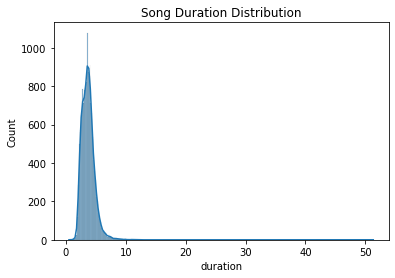

In [28]:
plt.title('Song Duration Distribution')
sns.histplot(data=df, x="duration", kde=True);


Before I even change the scale of that plot, I can see that there are outliers. Anything above ~10 minutes

In [29]:
df['duration'].describe()

count    23551.000000
mean         3.690223
std          1.135002
min          0.490000
25%          2.920000
50%          3.590000
75%          4.240000
max         51.320000
Name: duration, dtype: float64

There is also a song under 30 seconds

The average duration of a song is 3.6 minutes

Let's see how many tracks contained explicit values:

In [30]:
df.spotify_track_explicit.value_counts()

False    20977
True      2574
Name: spotify_track_explicit, dtype: int64

That's a good news; only 2574 songs contains explicit lyrics

Next, let's look at the distribution of spotify_track_popularity, danceability, energy, key, loudness, mode, speechiness, acousticness, instrumentalness, liveness, valence, tempo and time_signature:

popularity first:

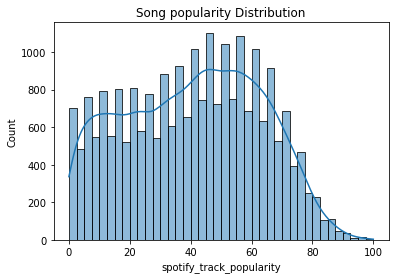

In [31]:
plt.title('Song popularity Distribution')
sns.histplot(data=df, x="spotify_track_popularity", kde=True);


some songs have a 0 popularity score! How many of them are above 90 ?

In [32]:
df[df['spotify_track_popularity'] > 90].count()

performer                    53
song                         53
spotify_genre                53
spotify_track_album          53
spotify_track_explicit       53
spotify_track_duration_ms    53
spotify_track_popularity     53
danceability                 53
energy                       53
key                          53
loudness                     53
mode                         53
speechiness                  53
acousticness                 53
instrumentalness             53
liveness                     53
valence                      53
tempo                        53
time_signature               53
duration                     53
dtype: int64

Only 53 songs have a popularity score higher than 90

Let's observe the 10 most popular songs:

In [279]:
df.sort_values('spotify_track_popularity', ascending=False)[0:10]

,performer,song,spotify_genre,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration,genre,artist + song
21,Tones And I,Dance Monkey,['australian pop'],Dance Monkey (Stripped Back) / Dance Monkey,0,209438.0,100.0,0.824,0.588,6.0,-6.400,0,0.0924,0.6920,0.000104,0.1490,0.513,98.027,4.0,3.49,[pop],Tones And I-Dance Monkey
341,Arizona Zervas,Roxanne,['pop rap'],ROXANNE,1,163636.0,99.0,0.621,0.601,6.0,-5.616,0,0.1480,0.0522,0.000000,0.4600,0.457,116.735,5.0,2.73,"[pop, rap]",Arizona Zervas-Roxanne
401,Maroon 5,Memories,"['pop', 'pop rock']",Memories,0,189486.0,98.0,0.764,0.320,11.0,-7.209,1,0.0546,0.8370,0.000000,0.0822,0.575,91.019,4.0,3.16,"[pop, rock]",Maroon 5-Memories
363,Post Malone,Circles,"['dfw rap', 'melodic rap', 'rap']",Hollywood's Bleeding,0,215280.0,98.0,0.695,0.762,0.0,-3.497,1,0.0395,0.1920,0.002440,0.0863,0.553,120.042,4.0,3.59,[rap],Post Malone-Circles
71,Dua Lipa,Don't Start Now,"['dance pop', 'pop', 'post-teen pop', 'uk pop']",Don't Start Now,0,183290.0,97.0,0.794,0.793,11.0,-4.521,0,0.0842,0.0125,0.000000,0.0952,0.677,123.941,4.0,3.05,[pop],Dua Lipa-Don't Start Now
161,Trevor Daniel,Falling,"['alternative r&b', 'melodic rap']",Falling,0,159381.0,97.0,0.784,0.430,10.0,-8.756,0,0.0364,0.1230,0.000000,0.0887,0.236,127.087,4.0,2.66,"[rap, r&b]",Trevor Daniel-Falling
115,Billie Eilish,everything i wanted,"['electropop', 'pop']",everything i wanted,0,245425.0,97.0,0.704,0.225,6.0,-14.454,0,0.0994,0.9020,0.657000,0.1060,0.243,120.006,4.0,4.09,"[pop, electro]",Billie Eilish-everything i wanted
18857,Mariah Carey,All I Want For Christmas Is You,"['dance pop', 'pop', 'r&b', 'urban contemporary']",Merry Christmas,0,241106.0,97.0,0.335,0.625,7.0,-7.462,1,0.0386,0.1640,0.000000,0.0708,0.346,150.277,4.0,4.02,"[pop, r&b, urban]",Mariah Carey-All I Want For Christmas Is You
290,Karol G & Nicki Minaj,Tusa,"['latin', 'reggaeton']",Tusa,0,200960.0,97.0,0.803,0.715,2.0,-3.280,1,0.2980,0.2950,0.000134,0.0574,0.574,101.085,4.0,3.35,"[latin, reggae, reggaeton]",Karol G & Nicki Minaj-Tusa
420,Billie Eilish,Bad Guy,"['electropop', 'pop']",WHEN WE ALL FALL ASLEE,0,194087.0,96.0,0.701,0.425,7.0,-10.965,1,0.3750,0.3280,0.130000,0.1000,0.562,135.128,4.0,3.23,"[pop, electro]",Billie Eilish-Bad Guy


There is a column indicating the danceability, let's see the danceability distribution and get some statistics:

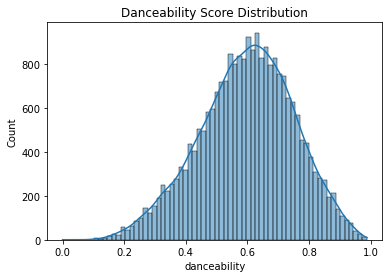

In [33]:
plt.title('Danceability Score Distribution')
sns.histplot(data=df, x="danceability", kde=True);


In [34]:
df['danceability'].describe()

count    23551.000000
mean         0.598175
std          0.152993
min          0.000000
25%          0.497000
50%          0.606000
75%          0.706000
max          0.988000
Name: danceability, dtype: float64

the average danceability score is approximatively 0.6 and the least danceable song has a score of 0 which is surprising. The most danceable song has a score of 0.98. Let's see which song has the highest danceable score:

In [280]:
df[df['danceability'] == 0.98]

,performer,song,spotify_genre,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration,genre,artist + song
1618,The Jacksons,State of Shock,"['disco', 'funk', 'motown', 'quiet storm', 'so...",Victory,0,271000.0,43.0,0.98,0.846,8.0,-7.696,0,0.1390,0.2830,0.14900,0.0520,0.891,121.562,4.0,4.52,"[funk, soul, disco]",The Jacksons-State of Shock
14059,Glee Cast,Ice Ice Baby,"['glee club', 'hollywood', 'post-teen pop']",Ice Ice Baby (Glee Cast Version),0,205120.0,35.0,0.98,0.816,7.0,-8.087,1,0.0831,0.0192,0.00298,0.0554,0.787,120.019,4.0,3.42,[pop],Glee Cast-Ice Ice Baby


I think I could have predicted this; one song is from The Jacksons. There are actually two songs with the max values and it's interesting to see that both of these songs have completely different genres.

The minimum danceability score is 0. Let's figure out which song it is:

In [35]:
df[df['danceability'] == 0]

,performer,song,spotify_genre,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration
9794,Jimmy Clanton,A Letter To An Angel,"['brill building pop', 'deep adult standards',...",All the Hits and More!,False,174614.0,7.0,0.0,0.287,3.0,-11.038,True,0.0,0.876,0.000005,0.112,0.0,0.0,0.0,2.91


There is also an energy song for each songs, let's observe the distribution of energy score and some statistics:

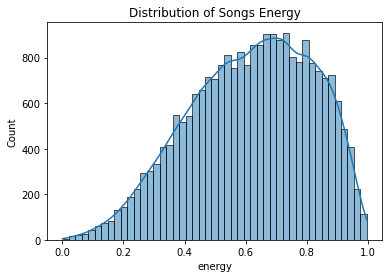

In [36]:
plt.title('Distribution of Songs Energy')
sns.histplot(data=df, x="energy", kde=True);

In [37]:
df['energy'].describe()

count    23551.000000
mean         0.618115
std          0.199970
min          0.000581
25%          0.473000
50%          0.634000
75%          0.779000
max          0.997000
Name: energy, dtype: float64

The average energy score is around 0.62 and the the songs with the least energy have a score of 0.000581 and the most energetic ones have a score of 0.99. 

When talking about music and songs, one of the main difference is the key of each songs or how the notes and chords are related to the major and minor scales. The keys here are represented with numbers and I found their significance looking at the data dictionary. Here are the keys corresponding to the numbers from 1 to 12: 0 = C , 1 = C#, 2 = D, 3 = D#, 4 = E, 5 = F, 6=F#, 7=G, 8= G#, 9 = A, 10 = A#, 11 = B, 12 = C+1

Let's observe the most poupular keys in our data frame as well as the least popular key:

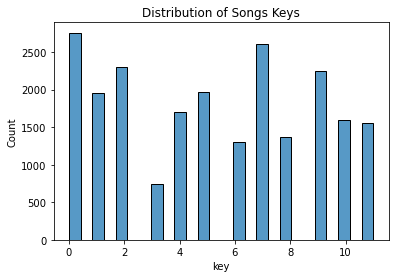

In [281]:
plt.title('Distribution of Songs Keys')
sns.histplot(data=df, x="key");

0 = C , 1 = C#, 2 = D, 3 = D#, 4 = E, 5 = F, 6=F#, 7=G, 8= G#, 9 = A, 10 = A#, 11 = B, 12 = C+1

In [39]:
df.key.value_counts()

0.0     2941
7.0     2779
2.0     2436
9.0     2391
5.0     2114
1.0     2074
4.0     1816
10.0    1718
11.0    1647
8.0     1464
6.0     1377
3.0      794
Name: key, dtype: int64

C, G and D are the most popular keys and D# is the least popular key in this dataframe

## Preprocessing

I want to have the song and the artist as output when using the recommender so I create a column with the performer and the song combined:

In [193]:
df['artist + song'] = df['performer'] + '-' + df['song']

I can now drop all the unecessary columns like the song, peformer, the first spotify_genre column and the album column since I don't use it:

In [195]:
rmd = df.drop(columns = ['performer','song','spotify_genre','spotify_track_album'])

I only want numerical features in my dataframe in order to compute the cosine similarities and build a recommender. I create dummied for the genres first:

In [202]:
one_hot_genre = rmd.genre.str.join('|').str.get_dummies().add_prefix('genre_')

I still have to drop some extra columns like the track duration in ms since I already created a duration column in minutes. I also drop the genre column because I created the dummies.The last column I drop is the artist + column in order to scale all the numerical values:

In [204]:
scaled_features = rmd.drop(columns = ['spotify_track_duration_ms','genre','artist + song'])

I also drop the track explicit and mode column since they are one hot encoded:

In [208]:
scaled_features.drop(columns = ['spotify_track_explicit','mode'], inplace=True)

I can now scale the numerical values:

In [209]:
SS = StandardScaler()
new_s = SS.fit_transform(scaled_features)

In [210]:
new_s

array([[ 2.25493642,  0.88768058,  1.08148673, ..., -1.43651421,
         0.21186073,  0.74176557],
       [ 2.11665958, -0.17143888, -1.1784712 , ..., -0.87272064,
         0.21186073, -0.09668703],
       [ 2.02447502, -0.36757212,  0.26970584, ..., -1.56549756,
         0.21186073, -0.3915275 ],
       ...,
       [ 0.59561432, -0.31526992, -0.53205308, ...,  0.58139353,
        -2.92169404,  0.22579474],
       [-0.46450813, -0.08644782, -0.23640448, ..., -1.57720385,
         0.21186073,  0.54827651],
       [-0.64887725, -1.83203359, -0.72247082, ...,  1.89346184,
        -2.92169404, -0.93513963]])

In [213]:
rmd_features = pd.DataFrame(new_s, columns=scaled_features.columns)

## Building the recommender 

I now have all the numerical features scaled and the dummies column for the genres, spotify_track_eexplicit and mode. Let's join these dataframes together and add the artist + song that will be the index:

In [216]:
recommender_df = rmd_features.join(one_hot_genre)

In [218]:
recommender = recommender_df.join(rmd['artist + song', 'spotify_track_explicit','mode'])

In [222]:
recommender = recommender.set_index('artist + song')

I have the dataframe set up the way I want to in order to build a recommender but the size of it can be reduced. Let's create a sparse version of it to be able to comfortably compute the cosine similarities of each song vectors:

In [224]:
recommender_sparse = sparse.csr_matrix(recommender.fillna(0))

Then, I first compute the pairwise distances and subtract them to 1 to get the cosine similarities: 

In [225]:
spotify = pairwise_distances(recommender_sparse, metric = 'cosine')

In [226]:
spotify = 1 - spotify

In [227]:
spotify.shape

(22112, 22112)

Columns and Rows will be the unique songs of the dataframe so I set index and the columns as the artist+song

In [228]:
spotify_df = pd.DataFrame(spotify, index=recommender.index, columns=recommender.index)

In [229]:
spotify_df.head()

artist + song,"Tainy, Anuel AA & Ozuna-Adicto",NaN,Lady Gaga & Bradley Cooper-Shallow,Post Malone Featuring DaBaby-Enemies,"Yella Beezy, Gucci Mane & Quavo-Bacc At It Again",Taylor Swift-The Archer,DaBaby-VIBEZ,NF-When I Grow Up,Post Malone-Hollywood's Bleeding,NaN,NLE Choppa-Famous Hoes,Taylor Swift-Cornelia Street,Chris Brown Featuring Gunna-Heat,NaN,Ant Saunders-Yellow Hearts,BTS Featuring Lauv-Make It Right,NF-Time,Rod Wave & Kevin Gates-Cuban Links,Roddy Ricch Featuring Meek Mill-Peta,DaBaby-INTRO,Chris Brown Featuring Justin Bieber & Ink-Don't Check On Me,Tones And I-Dance Monkey,The Weeknd-Heartless,"Ariana Grande-Break Up With Your Girlfriend, I'm Bored","DaBaby Featuring Chance The Rapper, Gucci Mane & YK Osiris-GOSPEL",Taylor Swift-Miss Americana & The Heartbreak Prince,Matt Stell-Prayed For You,Harry Styles-Golden,Young Thug Featuring Lil Baby-Bad Bad Bad,NaN,Harry Styles-Watermelon Sugar,NaN,Luke Combs-Better Together,The Chainsmokers & Illenium Featuring Lennon Stella-Takeaway,Dierks Bentley-Living,"Internet Money, Lil Tecca & A Boogie Wit da Hoodie-Somebody",NAV Featuring Meek Mill-Tap,Ellie Goulding & Juice WRLD-Hate Me,Taylor Swift-The Man,24kGoldn-Valentino,NaN,NaN,SHAED-Trampoline,Blake Shelton-God's Country,Halsey-Without Me,5 Seconds Of Summer-Easier,Chance The Rapper Featuring MadeinTYO & DaBaby-Hot Shower,J Balvin & Bad Bunny-Que Pretendes,Harry Styles-Falling,Travis Scott-HIGHEST IN THE ROOM,Niall Horan-Nice To Meet Ya,Young Thug-Just How It Is,Mariah Carey-All I Want For Christmas Is You,Shawn Mendes & Camila Cabello-Senorita,Post Malone-Internet,Lil Baby & DaBaby-Baby,DaBaby Featuring Lil Baby & Moneybagg Yo-TOES,Drake-Omerta,Drake-Club Paradise,J Balvin & Bad Bunny-La Cancion,Bryce Vine Featuring YG-La La Land,Sam Smith-How Do You Sleep?,Taylor Swift-Afterglow,"Dreamville Featuring Bas, JID, Guapdad 4000, Reese LAFLARE, Jace, Mez, Smokepurpp, Buddy & Ski Mask The Slump God-Costa Rica",The Ronettes-Sleigh Ride,Brenda Lee-Rockin' Around The Christmas Tree,YoungBoy Never Broke Again-Rich As Hell,Lana Del Rey-Doin' Time,Post Malone-Allergic,Juice WRLD-Lucid Dreams,Drake-The Motion,Dua Lipa-Don't Start Now,Kanye West-Jesus Is Lord,Chris Lane-I Don't Know About You,Blanco Brown-The Git Up,"French Montana Featuring Post Malone, Cardi B & Rvssian-Writing On The Wall",Post Malone-A Thousand Bad Times,A Boogie Wit da Hoodie-Look Back At It,NLE Choppa-Camelot,Halsey-Graveyard,Luke Combs-Beer Never Broke My Heart,DaBaby Featuring Kevin Gates-POP STAR,Florida Georgia Line-Talk You Out Of It,Kane Brown-Good As You,Megan Thee Stallion Featuring DaBaby-Cash Shit,Young Thug Featuring Future-Sup Mate,Trippie Redd-Love Me More,Chance The Rapper Featuring John Legend-All Day Long,DaBaby-BOP,Ali Gatie-It's You,Marshmello & Kane Brown-One Thing Right,Kanye West Featuring Fred Hammond-Hands On,Maren Morris-The Bones,Drake-Days In The East,XXXTENTACION Featuring PnB Rock & Trippie Redd-Bad Vibes Forever,Wale Featuring Jeremih-On Chill,Lil Uzi Vert-Sanguine Paradise,YoungBoy Never Broke Again-Hot Now,"Tyler, The Creator-Earfquake",Old Dominion-One Man Band,Nicki Minaj-MEGATRON,Nipsey Hussle Featuring Roddy Ricch & Hit-Boy-Racks In The Middle,Burl Ives-A Holly Jolly Christmas,Bad Bunny & Tainy-Callaita,Travis Scott-Sicko Mode,Chance The Rapper Featuring Death Cab For Cutie-Do You Remember,NaN,Morgan Wallen-Whiskey Glasses,Keith Urban-We Were,blackbear-Hot Girl Bummer,DaBaby-XXL,Camila Cabello-Liar,Trippie Redd Featuring YoungBoy Never Broke Again-Hate Me,Taylor Swift-Paper Rings,DaBaby Featuring Stunna 4 Vegas-REALLY,Billie Eilish-everything i wanted,Doja Cat & Tyga-Juicy,Young Thug-Lil Baby,NaN,Billie Eilish-When The Party's Over,Eli Young Band-Love Ain't,Lizzo-Good As Hell,Post Malone-Wow.,NaN,Normani-Motivation,Khalid Featuring A Boogie Wit da Hoodie-Right Back,Ariana Grande-7 Rings,"Dove Cameron, Sofia Carson, Booboo Stewart, Cameron Boyce, Thomas Doherty, China Anne McClain & Dylan Playfair-Night Falls","Young Thug, J. Co

Now let's try the recommender

In [285]:
df[df['performer'] == "Marvin Gaye"]

,performer,song,spotify_genre,spotify_track_album,spotify_track_explicit,spotify_track_duration_ms,spotify_track_popularity,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,duration,genre,artist + song
1210,Marvin Gaye,Hitch Hike,"['classic soul', 'funk', 'motown', 'northern s...",That Stubborn Kinda' Fellow,0,152226.0,28.0,0.829,0.801,1.0,-8.449,1,0.0382,0.3860,0.000000,0.1200,0.969,113.285,4.0,2.54,"[funk, soul]",Marvin Gaye-Hitch Hike
1932,Marvin Gaye,That's The Way Love Is,"['classic soul', 'funk', 'motown', 'northern s...",M.P.G.,0,222173.0,33.0,0.738,0.465,10.0,-10.720,0,0.0323,0.1700,0.000005,0.0747,0.901,110.643,4.0,3.70,"[funk, soul]",Marvin Gaye-That's The Way Love Is
2839,Marvin Gaye,One More Heartache,"['classic soul', 'funk', 'motown', 'northern s...",Moods Of Marvin Gaye,0,160293.0,19.0,0.507,0.604,9.0,-12.210,1,0.0333,0.2420,0.000000,0.1930,0.935,83.087,4.0,2.67,"[funk, soul]",Marvin Gaye-One More Heartache
4901,Marvin Gaye,Pride And Joy,"['classic soul', 'funk', 'motown', 'northern s...",That Stubborn Kinda' Fellow,0,155266.0,30.0,0.617,0.624,3.0,-8.661,1,0.0583,0.6620,0.000000,0.3080,0.875,119.372,4.0,2.59,"[funk, soul]",Marvin Gaye-Pride And Joy
5742,Marvin Gaye,I Heard It Through The Grapevine,"['classic soul', 'funk', 'motown', 'northern s...",In The Groove,0,194293.0,63.0,0.707,0.367,3.0,-10.788,0,0.0382,0.2620,0.000000,0.1150,0.621,117.257,4.0,3.24,"[funk, soul]",Marvin Gaye-I Heard It Through The Grapevine
5997,Marvin Gaye,Come Get To This,"['classic soul', 'funk', 'motown', 'northern s...",Let's Get It On,0,161360.0,41.0,0.660,0.568,0.0,-9.486,1,0.0397,0.2040,0.000002,0.2370,0.673,114.876,4.0,2.69,"[funk, soul]",Marvin Gaye-Come Get To This
8285,Marvin Gaye,Inner City Blues (Make Me Wanna Holler),"['classic soul', 'funk', 'motown', 'northern s...",What's Going On - 40th Anniversary (Super Deluxe),0,331960.0,59.0,0.633,0.600,11.0,-9.093,1,0.0339,0.7140,0.161000,0.0780,0.687,94.096,4.0,5.53,"[funk, soul]",Marvin Gaye-Inner City Blues (Make Me Wanna Ho...
11142,Marvin Gaye,Pretty Little Baby,"['classic soul', 'funk', 'motown', 'northern s...",The Master 1961-1984,0,155893.0,13.0,0.593,0.549,7.0,-6.591,0,0.0279,0.8000,0.000000,0.1180,0.865,109.465,4.0,2.60,"[funk, soul]",Marvin Gaye-Pretty Little Baby
11456,Marvin Gaye,Ain't That Peculiar,"['classic soul', 'funk', 'motown', 'northern s...",Moods Of Marvin Gaye,0,179693.0,47.0,0.564,0.771,9.0,-9.346,1,0.0474,0.1820,0.000000,0.6180,0.789,81.832,4.0,2.99,"[funk, soul]",Marvin Gaye-Ain't That Peculiar
11739,Marvin Gaye,Let's Get It On,"['classic soul', 'funk', 'motown', 'northern s...",Let's Get It On,0,290960.0,63.0,0.543,0.620,8.0,-10.629,1,0.0648,0.0379,0.000001,0.0559,0.607,167.141,4.0,4.85,"[funk, soul]",Marvin Gaye-Let's Get It On


In [272]:
spotify_df["Marvin Gaye-Let's Get It On"].sort_values(ascending=False)[1:11]

artist + song
Little Milton-If Walls Could Talk                    0.819026
Johnnie Taylor-Somebody's Sleeping In My Bed         0.817165
Don Covay-I Was Checkin' Out She Was Checkin' In     0.793600
Anita Baker-Same Ole Love (365 Days A Year)          0.788283
Fontella Bass-Recovery                               0.781400
NaN                                                  0.775853
The Artistics-Girl I Need You                        0.772472
Gladys Knight And The Pips-If I Were Your Woman      0.768253
Marvin Gaye-How Sweet It Is To Be Loved By You       0.760211
Garnet Mimms & The Enchanters-Baby Don't You Weep    0.757302
Name: Marvin Gaye-Let's Get It On, dtype: float64

### Notes !!

Some steps I need to take:

- Fix the hip hop genre that is not present because I split the spotify_genres strings using a space so hip and hop are divided in two words, consequently not present in the new genres column as 'hip hop'

- Add more EDA and use plotly for better looking visualization

- Change the keys to letters and create dummies

- drop the idea of artist + song for identification; the index should be just songs. The output of the recommender can be artist + songs

- I created too many unnecessary dataframes, need to fix that and the naming conventions !!

- Write a function with input where you just type a song and it returns the recommendations

- NaN's ???  

- Streamlit